# Tracking With Detectron2

Source : 
- https://detectron2.readthedocs.io/en/latest/tutorials/install.html

- https://www.youtube.com/watch?v=Pb3opEFP94U

- https://www.youtube.com/watch?v=bjay7fT934Y

- https://www.analyticsvidhya.com/blog/2019/10/detailed-guide-powerful-sift-technique-image-matching-python/

## Install Package

In [ ]:
!pip install pyyaml==5.1

     |████████████████████████████████| 274 kB 5.1 MB/s 
  Created wheel for pyyaml: filename=PyYAML-5.1-cp37-cp37m-linux_x86_64.whl size=44092 sha256=72a248389f943e641b0ba14bacb9662034469c872f0b25fde5f0e5b0ba879296
  Stored in directory: /root/.cache/pip/wheels/77/f5/10/d00a2bd30928b972790053b5de0c703ca87324f3fead0f2fd9
Successfully built pyyaml
  Attempting uninstall: pyyaml
    Found existing installation: PyYAML 3.13
    Uninstalling PyYAML-3.13:
      Successfully uninstalled PyYAML-3.13


In [ ]:
!pip install torch==1.7.1+cu101 torchvision==0.8.2+cu101 torchaudio==0.7.2 -f https://download.pytorch.org/whl/torch_stable.html

Looking in links: https://download.pytorch.org/whl/torch_stable.html
     |████████████████████████████████| 735.4 MB 15 kB/s 
     |████████████████████████████████| 12.8 MB 48.3 MB/s 
     |████████████████████████████████| 7.6 MB 1.1 MB/s 
  Attempting uninstall: torch
    Found existing installation: torch 1.10.0+cu111
    Uninstalling torch-1.10.0+cu111:
      Successfully uninstalled torch-1.10.0+cu111
  Attempting uninstall: torchvision
    Found existing installation: torchvision 0.11.1+cu111
    Uninstalling torchvision-0.11.1+cu111:
      Successfully uninstalled torchvision-0.11.1+cu111
  Attempting uninstall: torchaudio
    Found existing installation: torchaudio 0.10.0+cu111
    Uninstalling torchaudio-0.10.0+cu111:
      Successfully uninstalled torchaudio-0.10.0+cu111
ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependency conflicts.
torchtext 0.11.0 requires torch

In [ ]:
import torch
# print(torch.__version__)
# print(torch.cuda.is_available())
TORCH_VERSION = ".".join(torch.__version__.split(".")[:2])
CUDA_VERSION = torch.__version__.split("+")[-1]
print("torch: ", TORCH_VERSION, "; cuda: ", CUDA_VERSION)

torch:  1.7 ; cuda:  cu101


In [ ]:
# Install detectron2 that matches the above pytorch version
# See https://detectron2.readthedocs.io/tutorials/install.html for instructions
# !pip install detectron2 -f https://dl.fbaipublicfiles.com/detectron2/wheels/$CUDA_VERSION/torch$TORCH_VERSION/index.html
!pip install detectron2 -f https://dl.fbaipublicfiles.com/detectron2/wheels/cu101/torch1.7/index.html
# If there is not yet a detectron2 release that matches the given torch + CUDA version, you need to install a different pytorch.

# exit(0)  # After installation, you may need to "restart runtime" in Colab. This line can also restart runtime

Looking in links: https://dl.fbaipublicfiles.com/detectron2/wheels/cu101/torch1.7/index.html
     |████████████████████████████████| 6.1 MB 559 kB/s 
     |████████████████████████████████| 145 kB 5.1 MB/s 
     |████████████████████████████████| 130 kB 43.9 MB/s 
     |████████████████████████████████| 50 kB 7.0 MB/s 
     |████████████████████████████████| 74 kB 3.8 MB/s 
     |████████████████████████████████| 843 kB 43.9 MB/s 
     |████████████████████████████████| 749 kB 61.6 MB/s 
     |████████████████████████████████| 112 kB 68.4 MB/s 
  Created wheel for fvcore: filename=fvcore-0.1.5.post20220305-py3-none-any.whl size=61214 sha256=b963eb2dbc931f2969381b21aca0127f5dbc2a2a1a1599231e9469d4cbc7b6ad
  Stored in directory: /root/.cache/pip/wheels/b5/b7/6e/43b1693d06fac3633af48db68557513b0a37ab38b0a8b798f9
  Created wheel for antlr4-python3-runtime: filename=antlr4_python3_runtime-4.8-py3-none-any.whl size=141230 sha256=746b7565c3e2a57a58a840a157003dd03002cf39e9268af36f94bff2d231f53

In [ ]:
!pip uninstall opencv-python
# !pip install opencv-python==3.4.2.16
!pip install opencv-contrib-python==3.4.2.17

Found existing installation: opencv-python 4.1.2.30
Uninstalling opencv-python-4.1.2.30:
  Would remove:
    /usr/local/lib/python3.7/dist-packages/cv2/*
    /usr/local/lib/python3.7/dist-packages/opencv_python-4.1.2.30.dist-info/*
Proceed (y/n)? y
  Successfully uninstalled opencv-python-4.1.2.30
     |████████████████████████████████| 30.6 MB 1.3 MB/s 
  Attempting uninstall: opencv-contrib-python
    Found existing installation: opencv-contrib-python 4.1.2.30
    Uninstalling opencv-contrib-python-4.1.2.30:
      Successfully uninstalled opencv-contrib-python-4.1.2.30


## Import

In [ ]:
# import some common detectron2 utilities
import detectron2
from detectron2.utils.logger import setup_logger
setup_logger()

from detectron2 import model_zoo
from detectron2.engine import DefaultPredictor
from detectron2.config import get_cfg
from detectron2.utils.visualizer import ColorMode, Visualizer
from detectron2.data import MetadataCatalog, DatasetCatalog


# import some common libraries
import numpy as np

import cv2
print(f"opencv version {cv2.__version__}")
from google.colab.patches import cv2_imshow

from tqdm import tqdm
import matplotlib.pyplot as plt
from prettytable import PrettyTable as ptable
import warnings
import heapq

opencv version 3.4.2


## Google colab drive mount

In [ ]:
from google.colab import drive
drive.mount('/content/drive', force_remount=True)

Mounted at /content/drive


## Object Class from Detectron2

 ### Class list of Detectron2 model :
 - 0: u'background',
 - 1: u'person',
 - 2: u'bicycle',
 - 3: u'car',
 - 4: u'motorcycle',
 - 5: u'airplane',
 - 6: u'bus',
 - 7: u'train',
 - 8: u'truck',
 - 9: u'boat',
 - 10: u'traffic light',
 - 11: u'fire hydrant',
 - 12: u'stop sign',
 - 13: u'parking meter',
 - 14: u'bench',
 - 15: u'bird',
 - 16: u'cat',
 - 17: u'dog',
 - 18: u'horse',
 - 19: u'sheep',
 - 20: u'cow',
 - 21: u'elephant',
 - 22: u'bear',
 - 23: u'zebra',
 - 24: u'giraffe',
 - 25: u'backpack',
 - 26: u'umbrella',
 - 27: u'handbag',
 - 28: u'tie',
 - 29: u'suitcase',
 - 30: u'frisbee',
 - 31: u'skis',
 - 32: u'snowboard',
 - 33: u'sports ball',
 - 34: u'kite',
 - 35: u'baseball bat',
 - 36: u'baseball glove',
 - 37: u'skateboard',
 - 38: u'surfboard',
 - 39: u'tennis racket',
 - 40: u'bottle',
 - 41: u'wine glass',
 - 42: u'cup',
 - 43: u'fork',
 - 44: u'knife',
 - 45: u'spoon',
 - 46: u'bowl',
 - 47: u'banana',
 - 48: u'apple',
 - 49: u'sandwich',
 - 50: u'orange',
 - 51: u'broccoli',
 - 52: u'carrot',
 - 53: u'hot dog',
 - 54: u'pizza',
 - 55: u'donut',
 - 56: u'cake',
 - 57: u'chair',
 - 58: u'couch',
 - 59: u'potted plant',
 - 60: u'bed',
 - 61: u'dining table',
 - 62: u'toilet',
 - 63: u'tv',
 - 64: u'laptop',
 - 65: u'mouse',
 - 66: u'remote',
 - 67: u'keyboard',
 - 68: u'cell phone',
 - 69: u'microwave',
 - 70: u'oven',
 - 71: u'toaster',
 - 72: u'sink',
 - 73: u'refrigerator',
 - 74: u'book',
 - 75: u'clock',
 - 76: u'vase',
 - 77: u'scissors',
 - 78: u'teddy bear',
 - 79: u'hair drier',
 - 80: u'toothbrush'

---------------------------------------
## Useful Function

In [ ]:
def bb_intersection_over_union(boxA, boxB):
        # determine the (x, y)-coordinates of the intersection rectangle
        xA = max(boxA[0], boxB[0])
        yA = max(boxA[1], boxB[1])
        xB = min(boxA[2], boxB[2])
        yB = min(boxA[3], boxB[3])
        # compute the area of intersection rectangle
        interArea = max(0, xB - xA + 1) * max(0, yB - yA + 1)
        # compute the area of both the prediction and ground-truth
        # rectangles
        boxAArea = (boxA[2] - boxA[0] + 1) * (boxA[3] - boxA[1] + 1)
        boxBArea = (boxB[2] - boxB[0] + 1) * (boxB[3] - boxB[1] + 1)
        # compute the intersection over union by taking the intersection
        # area and dividing it by the sum of prediction + ground-truth
        # areas - the interesection area
        iou = interArea / float(boxAArea + boxBArea - interArea)
        # return the intersection over union value
        return round(iou,3)



def ShowBoxesOnImage(imagePath, coordinateCup1, coordinateCup2):

    image = cv2.imread(imagePath)

    # CUP 1 en black
    start_point = (coordinateCup1[0], coordinateCup1[1])
    end_point = (coordinateCup1[2], coordinateCup1[3])
    color = (0, 0, 0) 
    thickness = 3
    image = cv2.rectangle(image, start_point, end_point, color, thickness)

    # CUP 2 en rouge
    start_point = (coordinateCup2[0], coordinateCup2[1])
    end_point = (coordinateCup2[2], coordinateCup2[3])
    color = (0, 0, 255) 
    thickness = 2
    image = cv2.rectangle(image, start_point, end_point, color, thickness)

    cv2_imshow(image)




def BuildCoordinateFromText(string):
    
    x = string.split(" ")

    cup1Coord = np.array([int(x[0]), int(x[1]), int(x[0]) + int(x[2]), int(x[1]) + int(x[3])])
    cup2Coord = np.array([int(x[4]), int(x[5]), int(x[4]) + int(x[6]), int(x[5]) + int(x[7])]) 

    return cup1Coord, cup2Coord


-----------------------
## Define Detector class

In [ ]:
class Detector:
    def __init__(self, model_type = 'OD'):
        self.cfg = get_cfg()
        self.model_type = model_type

        # Load model config and pretrained model
        if (model_type == "OD"): # Object detection
            self.cfg.merge_from_file(model_zoo.get_config_file("COCO-Detection/faster_rcnn_R_101_FPN_3x.yaml"))
            self.cfg.MODEL.WEIGHTS = model_zoo.get_checkpoint_url("COCO-Detection/faster_rcnn_R_101_FPN_3x.yaml")
        
        elif (model_type == "IS"): # Instance segmentation
            self.cfg.merge_from_file(model_zoo.get_config_file("COCO-InstanceSegmentation/mask_rcnn_R_50_FPN_3x.yaml"))
            self.cfg.MODEL.WEIGHTS = model_zoo.get_checkpoint_url("COCO-InstanceSegmentation/mask_rcnn_R_50_FPN_3x.yaml")
        
        elif (model_type == "KP"): # keypoint detection
            self.cfg.merge_from_file(model_zoo.get_config_file("COCO-keypoint/keypoint_rcnn_R_50_FPN_3x.yaml"))
            self.cfg.MODEL.WEIGHTS = model_zoo.get_checkpoint_url("COCO-keypoint/keypoint_rcnn_R_50_FPN_3x.yaml")
        
        elif (model_type == "LVIS"): # LVIS Segmentation
            self.cfg.merge_from_file(model_zoo.get_config_file("LVISv0.5-InstanceSegmentation/mask_rcnn_X_101_32x8d_FPN_1x.yaml"))
            self.cfg.MODEL.WEIGHTS = model_zoo.get_checkpoint_url("LVISv0.5-InstanceSegmentation/mask_rcnn_X_101_32x8d_FPN_1x.yaml")
        
        elif (model_type == "PS"): # Panoptic Segmentation
            self.cfg.merge_from_file(model_zoo.get_config_file("COCO-PanopticSegmentation/panoptic_fpn_R_101_3X.yaml"))
            self.cfg.MODEL.WEIGHTS = model_zoo.get_checkpoint_url("COCO-PanopticSegmentation/panoptic_fpn_R_101_3X.yaml")
        

        self.cfg.MODEL.ROI_HEADS.SCORE_THRESH_TEST = 0.7
        self.cfg.MODEL.DEVICE = "cuda" #cpu or cuda

        self.predictor = DefaultPredictor(self.cfg)

        # To hold the value of the last image with the cup inside
        self.CupCoord = []
        self.blackCupCoord  = np.zeros((4,), dtype=int)
        self.redCupCoord    = np.zeros((4,), dtype=int)
        self.redCupNotFound = 0
        self.text           = ""
        self.debugText      = ""

        # For cup detection with sift algorithm
        self.SiftDescriptor = cv2.xfeatures2d.SIFT_create()
        self.siftMatcher    = cv2.BFMatcher(cv2.NORM_L1, crossCheck=True)
        self.blackCupDes    = 0
        self.redCupDes      = 0

        # for general tracking
        self.trackableImage = list()
        self.trackableDes    = list()
        self.trackableBoxes  = list()


    # Function to run the model on image ------------------------------------------------------------------
    def onImage(self, imagePath, save=False, savePath=None):
        image = cv2.imread(imagePath)
        
        if self.model_type != "PS":
            predictions = self.predictor(image)
            visualizer  = Visualizer(image[:,:,::-1], metadata = MetadataCatalog.get(self.cfg.DATASETS.TRAIN[0]),
                            instance_mode = ColorMode.IMAGE_BW) # SEGMENTATION or IMAGE_BW or IMAGE
            
            output      = visualizer.draw_instance_predictions(predictions["instances"].to("cpu"))

            # Getting the cup coordinate 
            # instanceCoord  = np.round(predictions["instances"][predictions["instances"]].pred_boxes.tensor.cpu().numpy()).astype('int') # Getting only the cup instance boxe
            # print(cupBoxesArray)

        else:
            predictions, segmentInfo = self.predictor(image)["panoptic_seg"]

            visualizer  = Visualizer(image[:,:,::-1], metadata = MetadataCatalog.get(self.cfg.DATASETS.TRAIN[0]))
            output      = visualizer.draw_panoptic_seg_predictions(predictions.to("cpu"), segmentInfo)


        cv2_imshow(output.get_image()[:,:,::-1])

        if(save and savePath != None):
            cv2.imwrite(savePath, output.get_image()[:,:,::-1])

        return 



# ------------------------------------------------------------------------------------------------------------------------------------
# This part below was created by Louis-Philippe Jodoin

    # Function to run the model on image ------------------------------------------------------------------
    def CupOnImage(self, imagePath, save=False, savePath=None):
        image = cv2.imread(imagePath)
        
        if self.model_type != "PS":
            predictions = self.predictor(image)
            visualizer  = Visualizer(image[:,:,::-1], metadata = MetadataCatalog.get(self.cfg.DATASETS.TRAIN[0]),
                            instance_mode = ColorMode.IMAGE_BW) # SEGMENTATION or IMAGE_BW or IMAGE
            
            output      = visualizer.draw_instance_predictions(predictions["instances"][predictions["instances"].pred_classes == 41].to("cpu"))
        else:
            predictions, segmentInfo = self.predictor(image)["panoptic_seg"]

            visualizer  = Visualizer(image[:,:,::-1], metadata = MetadataCatalog.get(self.cfg.DATASETS.TRAIN[0]))
            output      = visualizer.draw_panoptic_seg_predictions(predictions[predictions["instances"].pred_classes == 41].to("cpu"), segmentInfo)


        cv2_imshow(output.get_image()[:,:,::-1])

        if(save and savePath != None):
            cv2.imwrite(savePath, output.get_image()[:,:,::-1])

        return

# ------------------------------------------------------------------------------------------------------------------------------------
    # Function to initiate the tracking coordinate of the cup ------------------------------------------------------------------
    def InitiateCoordinateCup(self, imagePath, cup1Coord=0, cup2Coord=0, textFilePath=None, mot=False):
        if (mot == False):
            self.blackCupCoord = cup1Coord
            self.redCupCoord   = cup2Coord
            self.text          = f"1 1 {cup1Coord[0]} {cup1Coord[1]} {cup1Coord[2] - cup1Coord[0]} {cup1Coord[3] - cup1Coord[1]}\n"
            self.text         += f"1 2 {cup2Coord[0]} {cup2Coord[1]} {cup2Coord[2] - cup2Coord[0]} {cup2Coord[3] - cup2Coord[1]}\n"
            
            if (textFilePath != None):
                with open(textFilePath, 'w') as textFile:
                    # <frameid> <cupid> <xmin> <ymin> <width> <height>
                    textFile.write(self.text)
                    self.text = ""

            # Create sift desriptor of the cup
            image = cv2.imread(imagePath)

            grayImage = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)

            blackCup = grayImage[cup1Coord[1]:cup1Coord[3], cup1Coord[0]:cup1Coord[2]]
            # cv2_imshow(blackCup)

            redCup   = grayImage[cup2Coord[1]:cup2Coord[3], cup2Coord[0]:cup2Coord[2]]
            # cv2_imshow(redCup)

            _, self.blackCupDes = self.SiftDescriptor.detectAndCompute(blackCup, None)
            _, self.redCupDes   = self.SiftDescriptor.detectAndCompute(redCup, None)

            # red = image[cup2Coord[1]:cup2Coord[1]+100, cup2Coord[0]+50:cup2Coord[2]-50, 2]
            # print(red.mean())
        else:
            image = cv2.imread(imagePath)

            predictions = self.predictor(image)
            instances   = predictions["instances"]

            detectedClassIndexes = instances.pred_classes
            predictionBoxes      = np.round(instances.pred_boxes.tensor.cpu().numpy()).astype('int')

            grayImage = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)

            for n, boxe  in enumerate(predictionBoxes):
                
                self.text += f"1, n, {boxe[n][0]}, {boxe[n][1]}, {boxe[n][2] - boxe[n][0]}, {boxe[n][3], - boxe[n][1]}, -1, -1, -1, -1\n"

                miniframe  = grayImage[boxe[n][1]:boxe[n][3], boxe[n][0]:boxe[n][2]]

                self.trackableImage.append(miniframe)

                _ , des =  self.SiftDescriptor.detectAndCompute(miniframe, None)

                self.trackableDes.append(des)

                self.trackableBoxes.append(boxe)

            if (textFilePath != None):
                with open(textFilePath, 'w') as textFile:
                    # <frameid> <cupid> <xmin> <ymin> <width> <height>
                    textFile.write(self.text)
                    self.text = ""

          
    # Function to get the most recent Cup coordinate ------------------------------------------------------------------------         
    def GetCup1Coordinate(self):
        return self.blackCupCoord  

    def GetCup2Coordinate(self):
        return self.redCupCoord        



    # Function to record the bounding box of the cup object ------------------------------------------------------------------
    def RecordCupBoxCoordinates(self, imagePath, frameId=0, showCupImage=False):

        image = cv2.imread(imagePath)
        
        if self.model_type != "PS":
            predictions = self.predictor(image)

        else:
            predictions, segmentInfo = self.predictor(image)["panoptic_seg"]

        # Getting the cup coordinate 
        cupsBoxesCoordinates  = np.round(predictions["instances"][predictions["instances"].pred_classes == 41].pred_boxes.tensor.cpu().numpy()).astype('int')

        stringBlackCup = ""
        stringRedCup   = ""
        stringDebug    = ""

        # CupTopList = {"blackCup": -1,
        #               "redCup"  : -1 }

        blackCupMatchesList = []
        redCupMatchesList   = []

        blackCupIouList = []
        redCupIouList   = []

        cupPosition = np.zeros((len(cupsBoxesCoordinates),1), dtype=int)
        # redTopMeanList = []

        # bestBlackCupMatches = 0
        # bestRedCupMatches   = 0
        # bestBlackCupIou     = 0
        # bestRedCupIou       = 0

        threshold = 20

        for cupNb, coordinate in enumerate(cupsBoxesCoordinates):
            
            iouBlackCup = bb_intersection_over_union(coordinate, self.blackCupCoord)
            iouRedCup   = bb_intersection_over_union(coordinate, self.redCupCoord)

            grayImageCup = cv2.cvtColor(image[coordinate[1]:coordinate[3],coordinate[0]:coordinate[2]], cv2.COLOR_BGR2GRAY)

            # cv2_imshow(grayImageCup)

            _, cupDes = self.SiftDescriptor.detectAndCompute(grayImageCup, None)

            if cupDes is None:
                blackCupMatchesList.append(0)
                redCupMatchesList.append(0)

                blackCupIouList.append(0)
                redCupIouList.append(0)
                # redTopMeanList.append(0)
                continue

            blackCupMatches = self.siftMatcher.match(self.blackCupDes, cupDes)
            redCupMatches   = self.siftMatcher.match(self.redCupDes,   cupDes)
            
               
            # For unfound frame debug
            blackCupMatchesList.append(len(blackCupMatches))
            redCupMatchesList.append(len(redCupMatches))

            blackCupIouList.append(iouBlackCup)
            redCupIouList.append(iouRedCup)
            # ------------------------------

            # if (len(blackCupMatches) > bestBlackCupMatches and iouBlackCup != 0 and iouBlackCup > iouRedCup):
            #     CupTopList["blackCup"] = cupNb
            #     bestBlackCupMatches = len(blackCupMatches)

            # elif (len(redCupMatches) > bestRedCupMatches and iouRedCup != 0):
            #     CupTopList["redCup"] = cupNb
            #     bestRedCupMatches = len(redCupMatches)
            
            # red = image[coordinate[1]:coordinate[1]+100,coordinate[0]+25:coordinate[2]-25, 2]
            # redTopMeanList.append(round(red.mean(),2))
        # END FOR LOOP


        blackIndexMatch = blackCupMatchesList.index(max(blackCupMatchesList))
        blackIndexIou   = blackCupIouList.index(max(blackCupIouList))
        if ( (blackIndexMatch == blackIndexIou or blackCupMatchesList[blackIndexMatch] > threshold) and cupPosition[blackIndexMatch] == 0): #CupTopList["blackCup"] != -1):
            # self.blackCupCoord = cupsBoxesCoordinates[CupTopList["blackCup"]]
            cupPosition[blackIndexMatch] = 1
            self.blackCupCoord = cupsBoxesCoordinates[blackIndexMatch]
            # Updatre the sift model
            # if (frameId % 5 == 0):
            blackCupImage       = cv2.cvtColor(image[self.blackCupCoord[1]:self.blackCupCoord[3], self.blackCupCoord[0]:self.blackCupCoord[2]], cv2.COLOR_BGR2GRAY)
            _, self.blackCupDes = self.SiftDescriptor.detectAndCompute(blackCupImage, None)
        
        stringBlackCup = f"{frameId} 1 {self.blackCupCoord[0]} {self.blackCupCoord[1]} {self.blackCupCoord[2]-self.blackCupCoord[0]} {self.blackCupCoord[3]-self.blackCupCoord[1]}\n"

        redIndexMatch = redCupMatchesList.index(max(redCupMatchesList))
        redIndexIou   = redCupIouList.index(max(redCupIouList))
        if ((redIndexMatch == redIndexIou or redCupMatchesList[redIndexMatch] > threshold) and cupPosition[redIndexMatch] == 0): #CupTopList["redCup"] != -1):
            cupPosition[redIndexMatch] = 1
            self.redCupCoord    = cupsBoxesCoordinates[redIndexMatch]
            # Update the sift model
            # if (frameId % 5 == 0):
            redCupImage       = cv2.cvtColor(image[self.redCupCoord[1]:self.redCupCoord[3], self.redCupCoord[0]:self.redCupCoord[2]], cv2.COLOR_BGR2GRAY)
            _, self.redCupDes = self.SiftDescriptor.detectAndCompute(redCupImage, None)
        # else:
        #     self.redCupNotFound += 1
        #     if (len(redTopMeanList) and self.redCupNotFound > 5):
        #         redCupIndex      = redTopMeanList.index(max(redTopMeanList))
        #         if (redCupIndex != CupTopList["blackCup"] and redTopMeanList[redCupIndex] > 100):
        #             self.redCupNotFound = 0
        #             stringDebug += f"\n\n ******** Red cup switched on frame {frameId} with red mean value of {redTopMeanList[redCupIndex]} ******* \n"
        #             self.redCupCoord = cupsBoxesCoordinates[redCupIndex]


        stringRedCup = f"{frameId} 2 {self.redCupCoord[0]} {self.redCupCoord[1]} {self.redCupCoord[2]-self.redCupCoord[0]} {self.redCupCoord[3]-self.redCupCoord[1]}\n"

        self.text += stringBlackCup + stringRedCup
        

        # if (CupTopList["redCup"] == -1 or CupTopList["blackCup"] == -1):
        stringDebug += f"\n------------------ Frame {frameId} ------------------------------ \n"
        self.debugText += f"Black cup -> Best indexMatch = {blackIndexMatch} and best indexIou = {blackIndexIou}\n"
        self.debugText += f"Red cup -> Best indexMatch = {redIndexMatch} and best indexIou = {redIndexIou}\n"
        self.debugText += f"cupPosition array -> {cupPosition}\n"
        for cupID, coordinates in enumerate(cupsBoxesCoordinates):
            stringDebug += f"CUP number : {cupID}\n"
            stringDebug += f"blackCupMatches : {blackCupMatchesList[cupID]},  blackCupIou   : {blackCupIouList[cupID]}\n"
            stringDebug += f"redCupMatches   : {redCupMatchesList[cupID]},  redCupIouList : {redCupIouList[cupID]}\n"
            # stringDebug += f"redTopMeanList  : {redTopMeanList[cupID]}\n\n"
            
        self.debugText += stringDebug

        if(showCupImage and cupPosition[redIndexMatch] == 1 and cupPosition[blackIndexMatch] == 1):
            plt.figure()
            plt.subplot(1, 2, 1)
            plt.imshow(blackCupImage, cmap='gray')
            plt.title("Black Cup")
            plt.subplot(1, 2, 2)
            plt.imshow(redCupImage, cmap='gray')
            plt.title("Red Cup")
            plt.show()


    # Function to write the coordinate into a text file ------------------------------------------------------------------
    def WriteCoordinatesToTextFile(self, textFilePath=None):
        if (textFilePath != None):
            with open(textFilePath, 'a') as textFile:
                # <frameid> <cupid> <xmin> <ymin> <width> <height>
                textFile.write(self.text)
                self.text = ""

    # Function to write the coordinate into a text file ------------------------------------------------------------------
    def WriteDebugToTextFile(self, debugTextFilePath=None):
        if (debugTextFilePath != None):
            with open(debugTextFilePath, 'a') as textFile:
                # <frameid> <cupid> <xmin> <ymin> <width> <height>
                textFile.write(self.debugText)
                self.debugText = ""





    def TrackingWithBoxes(self, image, objectsBoxeCoordinates, frameId=0, textFilePath=None, debugTextFilePath=None):
        
        grayImage = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)

        if (frameId == 1):

            for n, boxe  in enumerate(objectsBoxeCoordinates):
                
                self.text += f"1, {n}, {boxe[0]}, {boxe[1]}, {boxe[2] - boxe[0]}, {boxe[3] - boxe[1]}, -1, -1, -1, -1\n"

                miniframe  = grayImage[boxe[1]:boxe[3], boxe[0]:boxe[2]]
                # cv2_imshow(miniframe)

                self.trackableImage.append(miniframe)

                _ , des =  self.SiftDescriptor.detectAndCompute(miniframe, None)

                self.trackableDes.append(des)

                self.trackableBoxes.append(boxe)

        else:
            newObjectListImage = []
            newObjectListDes   = []
            newObjectListBoxe  = []
            
            ObjectFoundList = np.zeros((len(self.trackableBoxes),1), dtype=int)

            threshold_low  = 10
            threshold_high = 20

            nbOfNewObjectsFound = len(objectsBoxeCoordinates) - len(self.trackableBoxes)

            self.debugText += f"\n------------------ Frame {frameId} ------------------------------ \n"
            self.debugText += f"Number of object detected -> {len(objectsBoxeCoordinates)}\n"

            for ObjetId, coordinate in enumerate(objectsBoxeCoordinates):
                
                grayImageObject = grayImage[coordinate[1]:coordinate[3],coordinate[0]:coordinate[2]]
                _, objetDes = self.SiftDescriptor.detectAndCompute(grayImageObject, None)

                if objetDes is None:
                    continue

                objectMatchesList = []
                objectIouList     = []

                self.debugText += f"\nObject id : {ObjetId}\n"
                self.debugText += f"Coordinate  : {coordinate[0]}, {coordinate[1]} {coordinate[2]-coordinate[0]} {coordinate[3]-coordinate[1]}\n"

                for Id, objectBoxe in enumerate(self.trackableBoxes):
                    
                    iouObject     = bb_intersection_over_union(coordinate, objectBoxe)
                    objectMatches = self.siftMatcher.match(self.trackableDes[Id], objetDes)
                    nbOfMatches   = len(objectMatches)
                    self.debugText += f"ID : {Id} -> iouObject : {iouObject}, objectMatches : {nbOfMatches}\n"

                    if (iouObject == 0 and nbOfMatches < threshold_low):
                        objectIouList.append(0)
                        objectMatchesList.append(0)
                        continue
                    else:
                        objectIouList.append(iouObject)
                        objectMatchesList.append(nbOfMatches)

                    

                indexMatch = objectMatchesList.index(max(objectMatchesList))
                indexIou   = objectIouList.index(max(objectIouList))
                self.debugText += f"\nBest indexMatch = {indexMatch} and best indexIou = {indexIou}\n"
                if ( (indexMatch == indexIou and ObjectFoundList[indexMatch] == 0) or objectMatchesList[indexMatch] > threshold_high):
                    ObjectFoundList[indexMatch]     = 1
                    self.trackableBoxes[indexMatch] = coordinate
                    self.trackableDes[indexMatch]   = objetDes

                    self.debugText += f"Matched with : {indexMatch} \n"

                    self.text += f"{frameId}, {indexMatch}, {coordinate[0]}, {coordinate[1]} {coordinate[2]-coordinate[0]} {coordinate[3]-coordinate[1]}, -1, -1, -1, -1\n"

                elif (nbOfNewObjectsFound > 0):
                    newObjectListImage.append(grayImageObject)
                    newObjectListDes.append(objetDes)
                    newObjectListBoxe.append(coordinate)



            if (len(newObjectListBoxe) > 0):
                for i, boxe in enumerate(newObjectListBoxe):
                    self.debugText += f"\nNew object identified : {boxe} \n"
                    self.trackableBoxes.append(boxe)
                    self.trackableImage.append(newObjectListImage[i])
                    self.trackableDes.append(newObjectListDes[i])
                    
                    self.text += f"{frameId}, {len(self.trackableBoxes)}, {boxe[0]}, {boxe[1]} {boxe[2]-boxe[0]} {boxe[3]-boxe[1]}, -1, -1, -1, -1\n"

        
        if (textFilePath != None):
            with open(textFilePath, 'a') as textFile:
                # <frameid> <cupid> <xmin> <ymin> <width> <height>
                textFile.write(self.text)
                self.text = ""
        else:
            self.text = ""
        
        if (debugTextFilePath != None):
            with open(debugTextFilePath, 'a') as textFile:
                # <frameid> <cupid> <xmin> <ymin> <width> <height>
                textFile.write(self.debugText)
                self.debugText = ""
        else:
            self.debugText = ""



    # Function to track general objet -------------------------------------------------------------------------------
    def GeneralObjectTrackingOnVideo(self, videoPath, textFilePath=None, debugTextFilePath=None, showImage=False, save=False, savePath=None):

        try:
            cap = cv2.VideoCapture(videoPath)

            if (cap.isOpened() == False):
                print("Error opening the file...")
                return


            (successful, image) = cap.read()

            #  Creating the saving object if argument save is True
            if (successful and save and savePath != None):
                height, width, lyers = image.shape
                size = (width, height)

                videoWrite = cv2.VideoWriter('Tracking.avi', cv2.VideoWriter_fourcc(*'DIVX'), 15, size)

            frameId = 1

            while successful:
                print(f"\rFrameID : {frameId}", end="")

                if self.model_type != "PS":
                    predictions = self.predictor(image)
                    visualizer  = Visualizer(image[:,:,::-1], metadata = MetadataCatalog.get(self.cfg.DATASETS.TRAIN[0]),
                                    instance_mode = ColorMode.IMAGE_BW) # SEGMENTATION or IMAGE_BW or IMAGE
                    output      = visualizer.draw_instance_predictions(predictions["instances"].to("cpu"))
                else:
                    predictions, segmentInfo = self.predictor(image)["panoptic_seg"]
                    visualizer  = Visualizer(image[:,:,::-1], metadata = MetadataCatalog.get(self.cfg.DATASETS.TRAIN[0]))
                    output      = visualizer.draw_panoptic_seg_predictions(predictions.to("cpu"), segmentInfo)

                instances   = predictions["instances"]

                # detectedClassIndexes = instances.pred_classes.tensor.cpu().numpy()
                predictionBoxes      = np.round(instances.pred_boxes.tensor.cpu().numpy()).astype('int')

                self.TrackingWithBoxes(image, predictionBoxes, frameId, textFilePath, debugTextFilePath)
                frameId += 1

                # Show the image
                if (showImage):
                    cv2_imshow(output.get_image()[:,:,::-1])

                # Save the image if argument save is True
                if (save and savePath != None):
                    videoWrite.write(output.get_image()[:,:,::-1])

                # Look if the user want to quit
                key = cv2.waitKey(1) & 0xFF

                if (key == ord("q")):
                    break
                
                # Capture the next image
                (successful, image) = cap.read()

            # Release the videoWrite object the image if argument save is True
            if (save and savePath != None):
                videoWrite.release()

        # Catch the open cv2 exception 
        except cv2.error as error:
            print(error)
            return





    # Function to run the model on video ------------------------------------------------------------------
    def onVideo(self, videoPath, save=False, savePath=None):
        try:
            cap = cv2.VideoCapture(videoPath)

            if (cap.isOpened() == False):
                print("Error opening the file...")
                return

            (successful, image) = cap.read()

            #  Creating the saving object if argument save is True
            if (successful and save and savePath != None):
                height, width, lyers = image.shape
                size = (width, height)

                videoWrite = cv2.VideoWriter('Tracking.avi', cv2.VideoWriter_fourcc(*'DIVX'), 15, size)


            while successful:
                if self.model_type != "PS":
                    predictions = self.predictor(image)

                    visualizer  = Visualizer(image[:,:,::-1], metadata = MetadataCatalog.get(self.cfg.DATASETS.TRAIN[0]),
                                    instance_mode = ColorMode.IMAGE_BW) # SEGMENTATION or IMAGE_BW or IMAGE
                    output      = visualizer.draw_instance_predictions(predictions["instances"].to("cpu"))

                else:
                    predictions, segmentInfo = self.predictor(image)["panoptic_seg"]

                    visualizer  = Visualizer(image[:,:,::-1], metadata = MetadataCatalog.get(self.cfg.DATASETS.TRAIN[0]))
                    output      = visualizer.draw_panoptic_seg_predictions(predictions.to("cpu"), segmentInfo)

                # Show the image
                cv2_imshow(output.get_image()[:,:,::-1])

                # Save the image if argument save is True
                if (save and savePath != None):
                    videoWrite.write(output.get_image()[:,:,::-1])

                # Look if the user want to quit
                key = cv2.waitKey(1) & 0xFF

                if (key == ord("q")):
                    break
                
                # Capture the next image
                (successful, image) = cap.read()

            # Release the videoWrite object the image if argument save is True
            if (save and savePath != None):
                videoWrite.release()

        # Catch the open cv2 exception 
        except cv2.error as error:
            print(error)
            return


------------------
## MAIN CODE

### Create the detector

In [ ]:
detector = Detector()

The checkpoint state_dict contains keys that are not used by the model:
  proposal_generator.anchor_generator.cell_anchors.{0, 1, 2, 3, 4}


### Run the detection on MOT videos

In [ ]:
videoPath = "drive/My Drive/Colab Notebooks/TP3Vision/MOT17-01-SDP-raw.webm"
textFilePath = "drive/My Drive/Colab Notebooks/TP3Vision/MOT17-01-SDP.txt"
# debugTextFilePath = "drive/My Drive/Colab Notebooks/TP3Vision/debug.txt"

detector.GeneralObjectTrackingOnVideo(videoPath, textFilePath, debugTextFilePath=None, showImage=False, save=False, savePath=None)


In [ ]:
videoPath = "drive/My Drive/Colab Notebooks/TP3Vision/MOT17-03-SDP-raw.webm"
textFilePath = "drive/My Drive/Colab Notebooks/TP3Vision/MOT17-03-SDP.txt"
# debugTextFilePath = "drive/My Drive/Colab Notebooks/TP3Vision/debug.txt"

detector.GeneralObjectTrackingOnVideo(videoPath, textFilePath, debugTextFilePath=None, showImage=False, save=False, savePath=None)

In [ ]:
videoPath = "drive/My Drive/Colab Notebooks/TP3Vision/MOT17-06-SDP-raw.webm"
textFilePath = "drive/My Drive/Colab Notebooks/TP3Vision/MOT17-06-SDP.txt"
# debugTextFilePath = "drive/My Drive/Colab Notebooks/TP3Vision/debug.txt"

detector.GeneralObjectTrackingOnVideo(videoPath, textFilePath, debugTextFilePath=None, showImage=False, save=False, savePath=None)

In [ ]:
videoPath = "drive/My Drive/Colab Notebooks/TP3Vision/MOT17-07-SDP-raw.webm"
textFilePath = "drive/My Drive/Colab Notebooks/TP3Vision/MOT17-07-SDP.txt"
# debugTextFilePath = "drive/My Drive/Colab Notebooks/TP3Vision/debug.txt"

detector.GeneralObjectTrackingOnVideo(videoPath, textFilePath, debugTextFilePath=None, showImage=False, save=False, savePath=None)

In [ ]:
videoPath = "drive/My Drive/Colab Notebooks/TP3Vision/MOT17-08-SDP-raw.webm"
textFilePath = "drive/My Drive/Colab Notebooks/TP3Vision/MOT17-08-SDP.txt"
# debugTextFilePath = "drive/My Drive/Colab Notebooks/TP3Vision/debug.txt"

detector.GeneralObjectTrackingOnVideo(videoPath, textFilePath, debugTextFilePath=None, showImage=False, save=False, savePath=None)

In [ ]:
videoPath = "drive/My Drive/Colab Notebooks/TP3Vision/MOT17-12-SDP-raw.webm"
textFilePath = "drive/My Drive/Colab Notebooks/TP3Vision/MOT17-12-SDP.txt"
# debugTextFilePath = "drive/My Drive/Colab Notebooks/TP3Vision/debug.txt"

detector.GeneralObjectTrackingOnVideo(videoPath, textFilePath, debugTextFilePath=None, showImage=False, save=False, savePath=None)

In [ ]:
videoPath = "drive/My Drive/Colab Notebooks/TP3Vision/MOT17-13-SDP-raw.webm"
textFilePath = "drive/My Drive/Colab Notebooks/TP3Vision/MOT17-13-SDP.txt"
# debugTextFilePath = "drive/My Drive/Colab Notebooks/TP3Vision/debug.txt"

detector.GeneralObjectTrackingOnVideo(videoPath, textFilePath, debugTextFilePath=None, showImage=False, save=False, savePath=None)

### Run the detection on cup images

In [ ]:
def RunTrackingImageRange(imagePath, textFilePath, debugTextFilePath, start, end):
    for i in tqdm(range(start,end)):
        imagePath = imagePath[:53] + str(i) + ".jpg"
        # print(imagePath)
        if (i % 50):
            detector.RecordCupBoxCoordinates(imagePath, i, showCupImage=False)
        else:
            detector.RecordCupBoxCoordinates(imagePath, i, showCupImage=True)

    detector.WriteCoordinatesToTextFile(textFilePath)
    detector.WriteDebugToTextFile(debugTextFilePath)

    ShowBoxesOnImage(imagePath, detector.GetCup1Coordinate() , detector.GetCup2Coordinate())

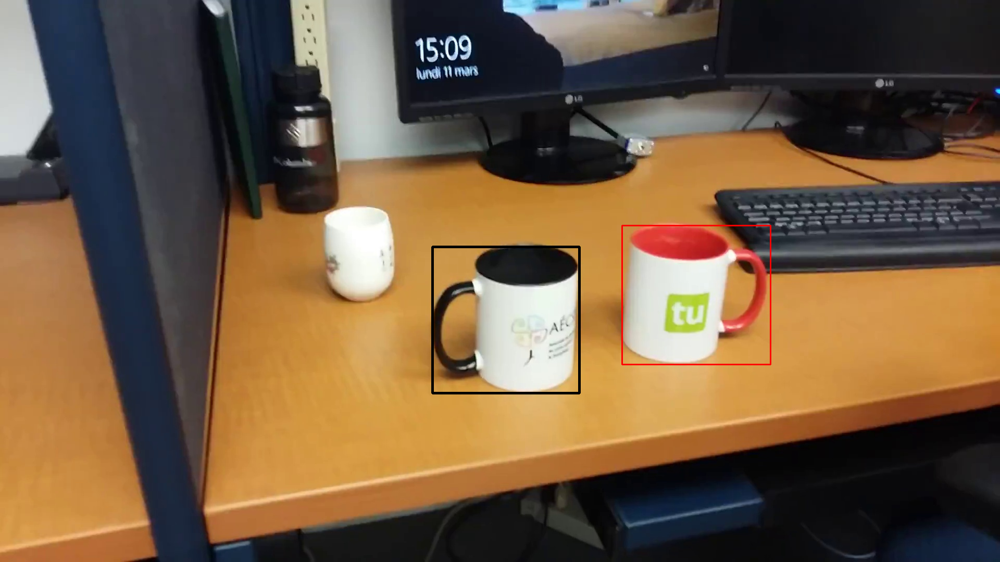

In [ ]:
imagePath = "drive/My Drive/Colab Notebooks/TP3Vision/frames/frame1.jpg"
savePath  = "drive/My Drive/Colab Notebooks/TP3Vision/detections/frame1.jpg"
textFilePath = "drive/My Drive/Colab Notebooks/TP3Vision/Results.txt"
debugTextFilePath = "drive/My Drive/Colab Notebooks/TP3Vision/debug.txt"

cup1Coord = np.array([830, 474, 830+282, 474+281])
cup2Coord = np.array([1194, 433, 1194+285, 433+267])

detector.InitiateCoordinateCup(imagePath, cup1Coord, cup2Coord, textFilePath)
# detector.onImage(imagePath)#, save=True, savePath= savePath)
ShowBoxesOnImage(imagePath, detector.GetCup1Coordinate() , detector.GetCup2Coordinate())

100%|██████████| 48/48 [00:33<00:00,  1.44it/s]


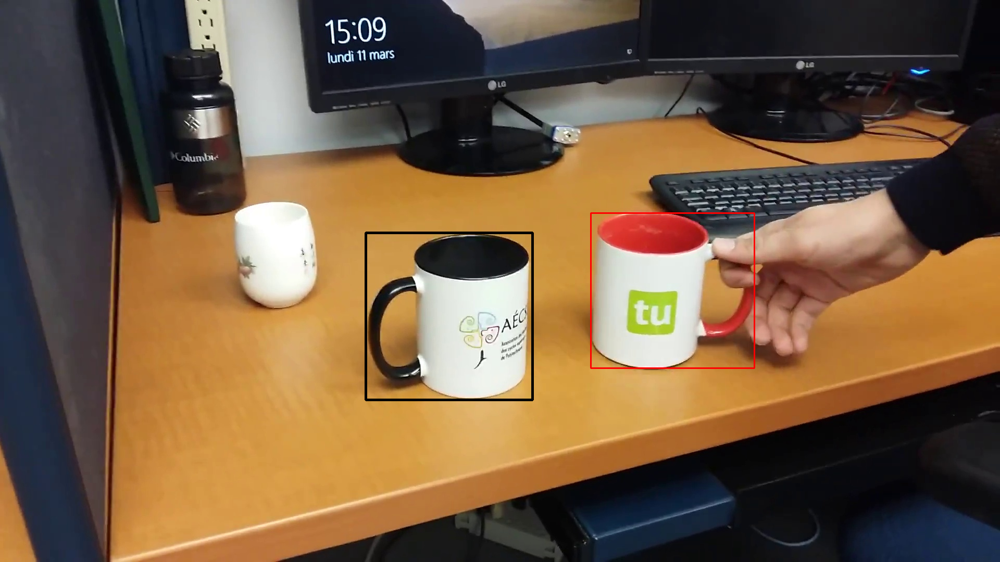

In [ ]:
RunTrackingImageRange(imagePath, textFilePath, debugTextFilePath, 2, 50)

  0%|          | 0/50 [00:00<?, ?it/s]

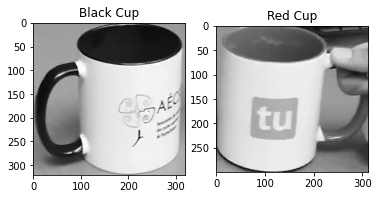

100%|██████████| 50/50 [00:35<00:00,  1.42it/s]


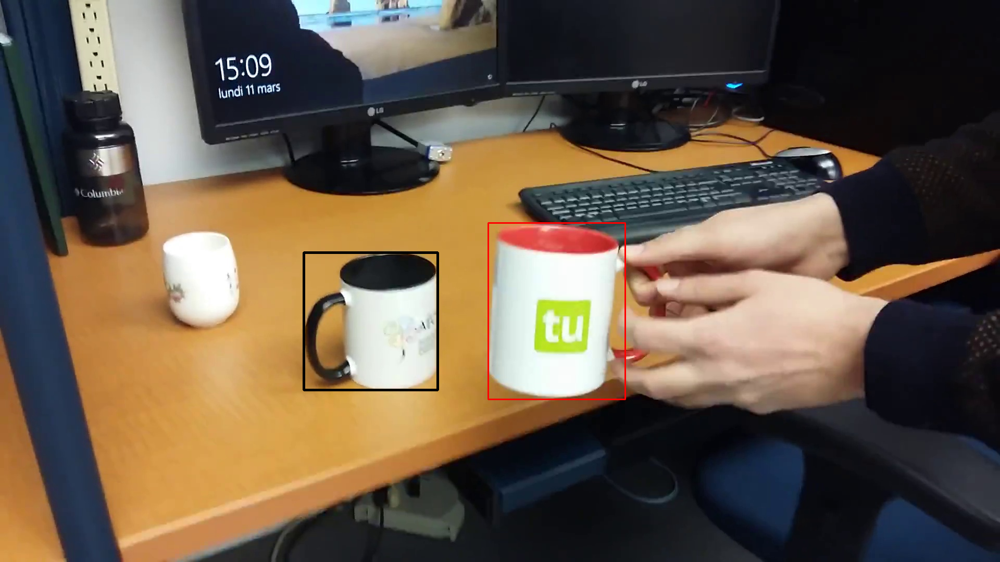

In [ ]:
RunTrackingImageRange(imagePath, textFilePath, debugTextFilePath, 50, 100)

  0%|          | 0/50 [00:00<?, ?it/s]

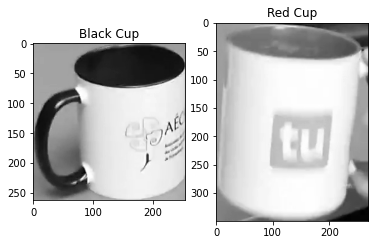

100%|██████████| 50/50 [00:33<00:00,  1.51it/s]


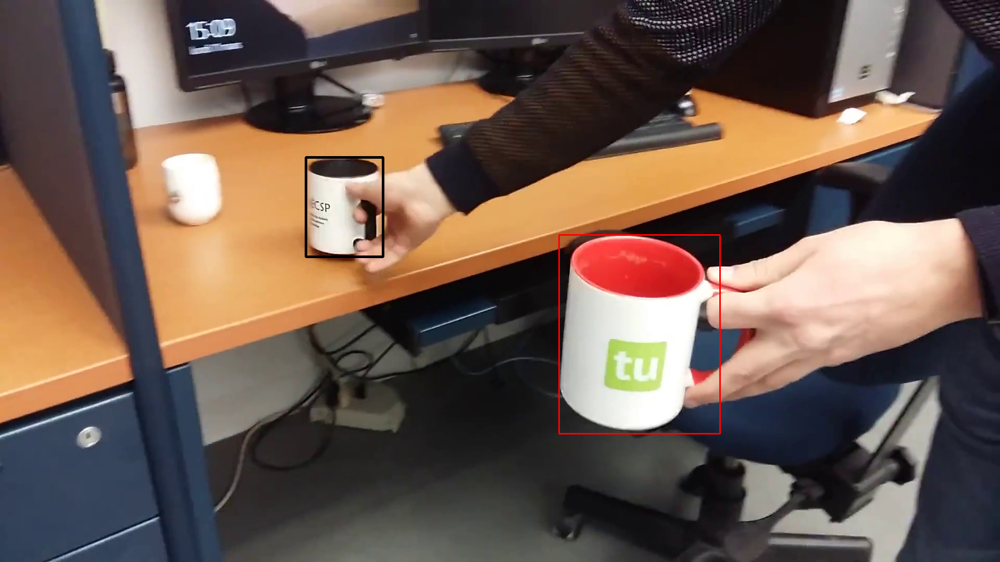

In [ ]:
RunTrackingImageRange(imagePath, textFilePath, debugTextFilePath, 100, 150)

  0%|          | 0/50 [00:00<?, ?it/s]

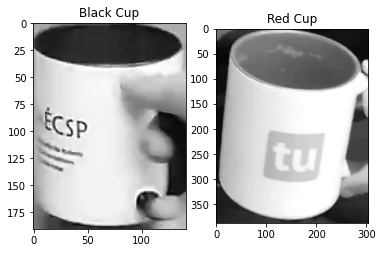

100%|██████████| 50/50 [00:35<00:00,  1.41it/s]


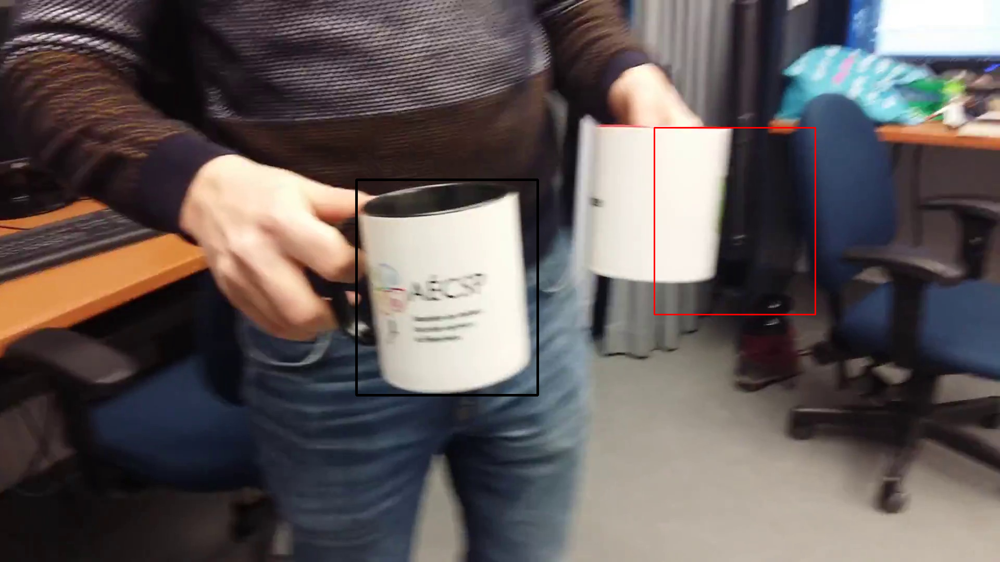

In [ ]:
RunTrackingImageRange(imagePath, textFilePath, debugTextFilePath, 150, 200)

100%|██████████| 50/50 [00:33<00:00,  1.50it/s]


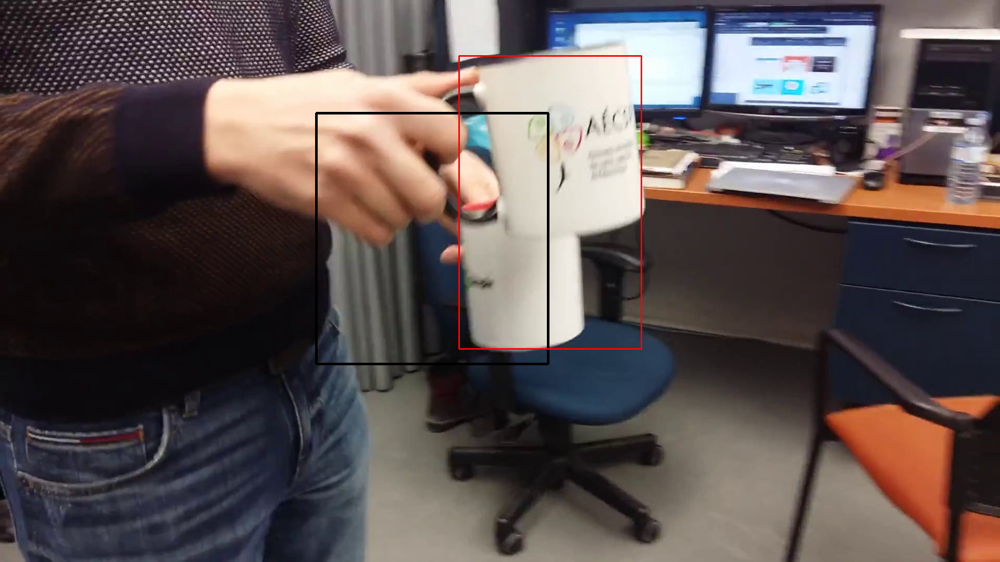

In [ ]:
RunTrackingImageRange(imagePath, textFilePath, debugTextFilePath, 200, 250)

100%|██████████| 50/50 [00:33<00:00,  1.48it/s]


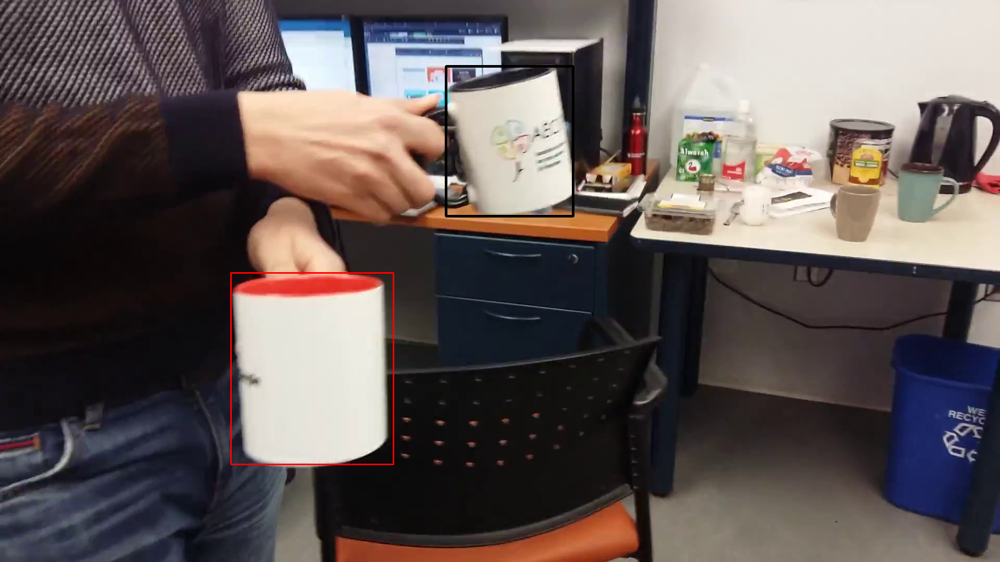

In [ ]:
RunTrackingImageRange(imagePath, textFilePath, debugTextFilePath, 250, 300)

100%|██████████| 50/50 [00:34<00:00,  1.46it/s]


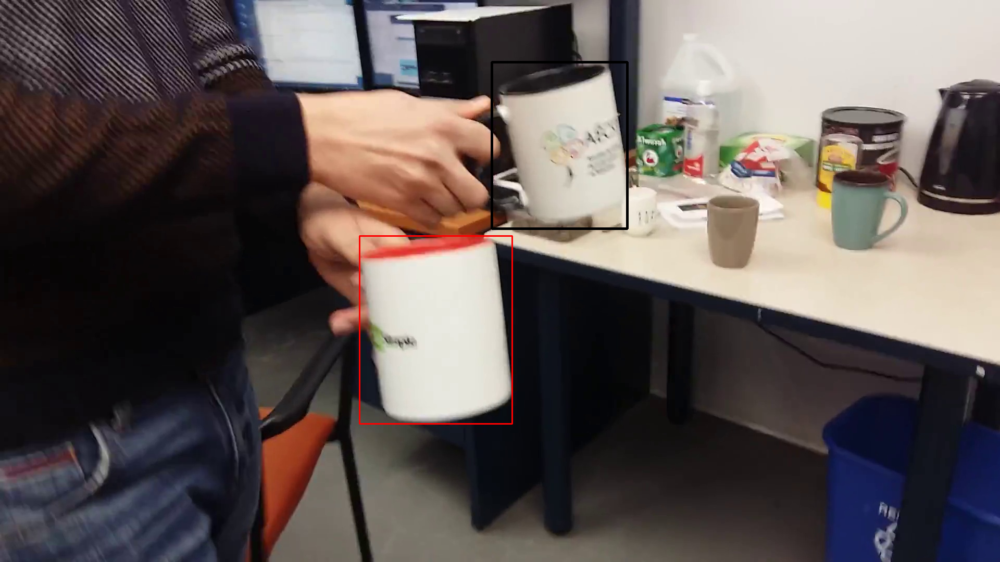

In [ ]:
RunTrackingImageRange(imagePath, textFilePath, debugTextFilePath, 300, 350)

  0%|          | 0/50 [00:00<?, ?it/s]

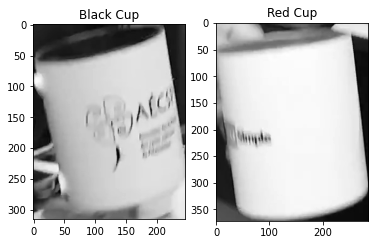

100%|██████████| 50/50 [00:35<00:00,  1.43it/s]


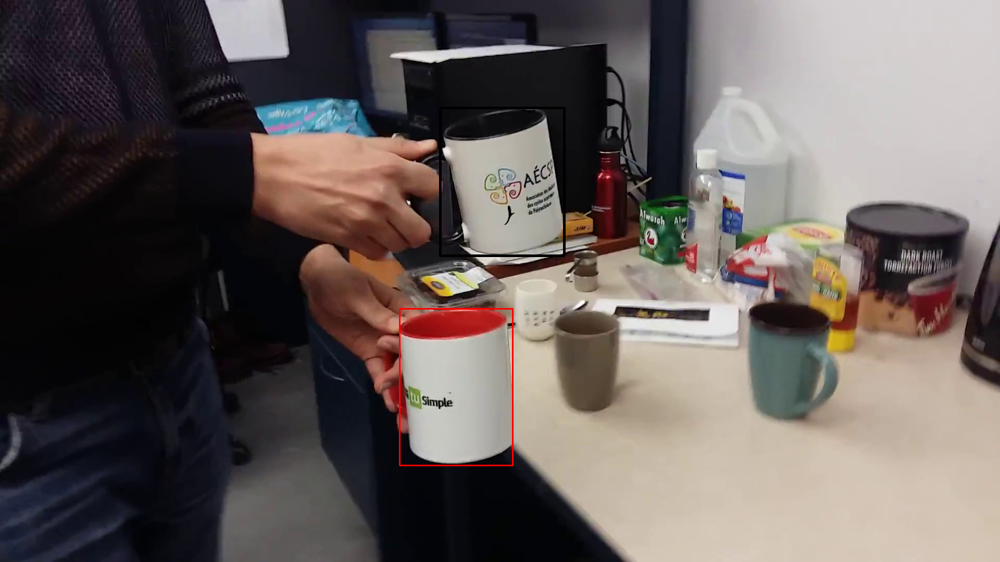

In [ ]:
RunTrackingImageRange(imagePath, textFilePath, debugTextFilePath, 350, 400)

  0%|          | 0/50 [00:00<?, ?it/s]

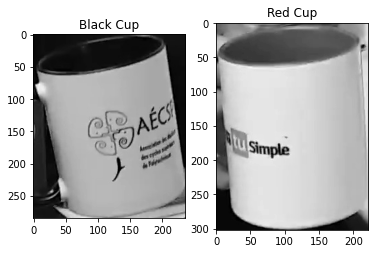

100%|██████████| 50/50 [00:35<00:00,  1.40it/s]


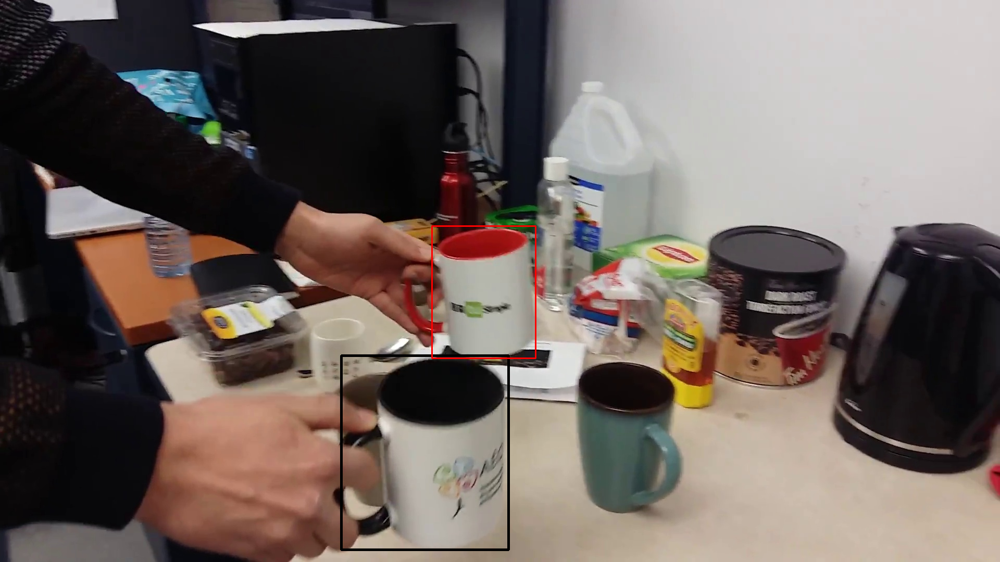

In [ ]:
RunTrackingImageRange(imagePath, textFilePath, debugTextFilePath, 400, 450)

  0%|          | 0/50 [00:00<?, ?it/s]

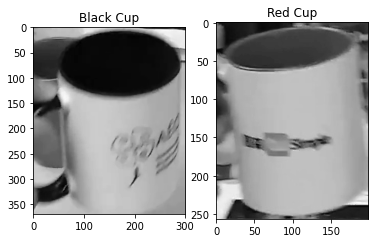

100%|██████████| 50/50 [00:35<00:00,  1.42it/s]


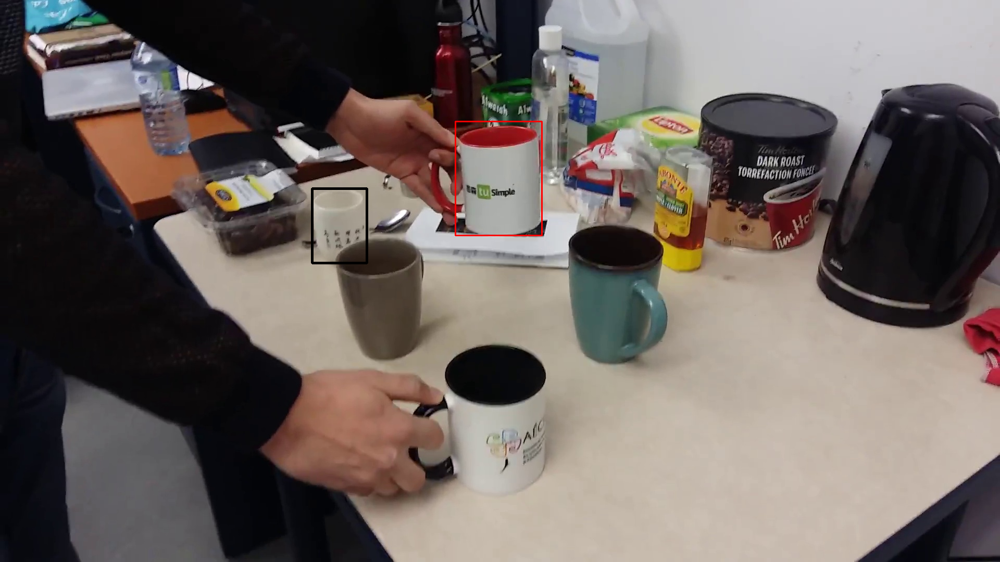

In [ ]:
RunTrackingImageRange(imagePath, textFilePath, debugTextFilePath, 450, 500)

  0%|          | 0/50 [00:00<?, ?it/s]

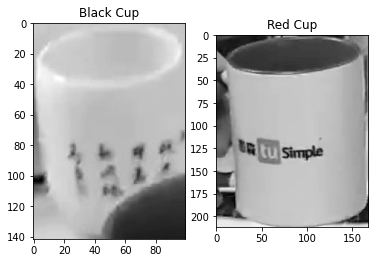

100%|██████████| 50/50 [01:20<00:00,  1.61s/it]


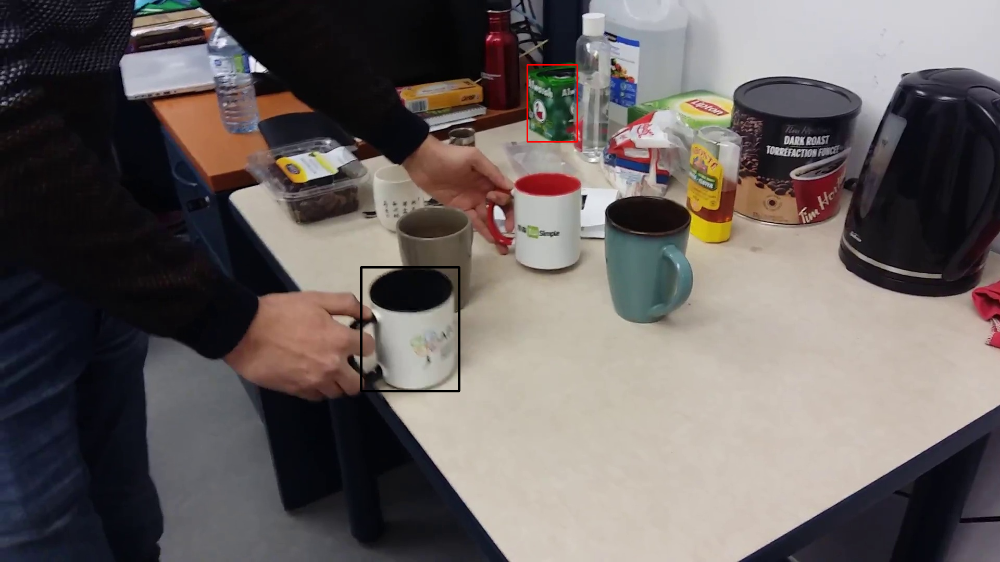

In [ ]:
RunTrackingImageRange(imagePath, textFilePath, debugTextFilePath, 500, 550)

100%|██████████| 50/50 [01:14<00:00,  1.50s/it]


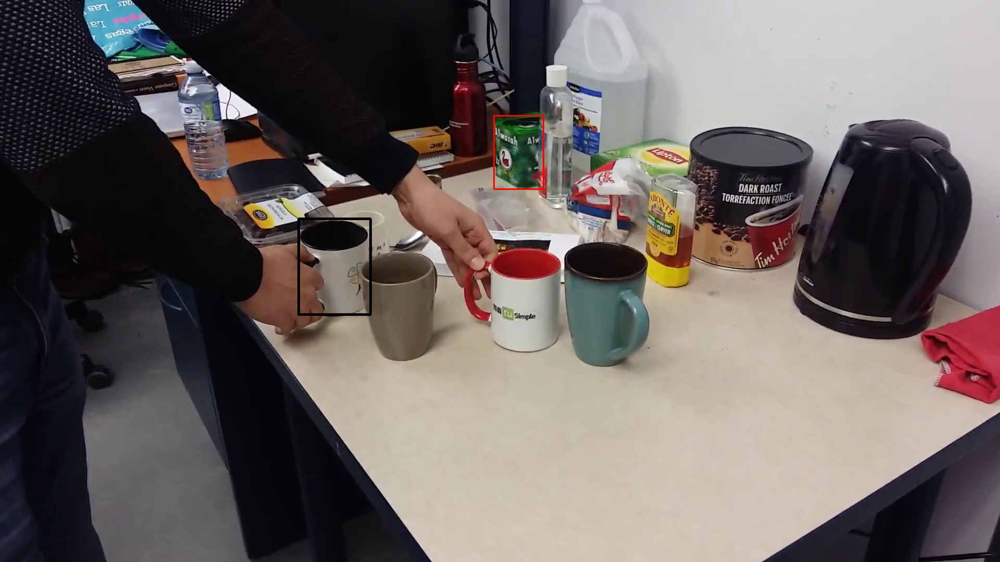

In [ ]:
RunTrackingImageRange(imagePath, textFilePath, debugTextFilePath, 550, 600)

------
### Testing the boxes found

In [ ]:
imagePath = "drive/My Drive/Colab Notebooks/TP3Vision/frames/frame422.jpg"
savePath  = "drive/My Drive/Colab Notebooks/TP3Vision/detections/frame1.jpg"
textFilePath = "drive/My Drive/Colab Notebooks/TP3Vision/Results.txt"

cup1Coord = np.array([755, 317, 755+276, 317+366])
cup2Coord = np.array([689, 617, 689+205, 617+276])

detector.InitiateCoordinateCup(imagePath, cup1Coord, cup2Coord, textFilePath)
# detector.onImage(imagePath)#, save=True, savePath= savePath)
ShowBoxesOnImage(imagePath, detector.GetCup1Coordinate() , detector.GetCup2Coordinate())


for i in tqdm(range(422,440)):
    imagePath = imagePath[:53] + str(i) + ".jpg"
    # print(imagePath)
    detector.RecordCupBoxCoordinates(imagePath, i)

detector.WriteCoordinatesToTextFile(textFilePath)

ShowBoxesOnImage(imagePath, detector.GetCup1Coordinate() , detector.GetCup2Coordinate())

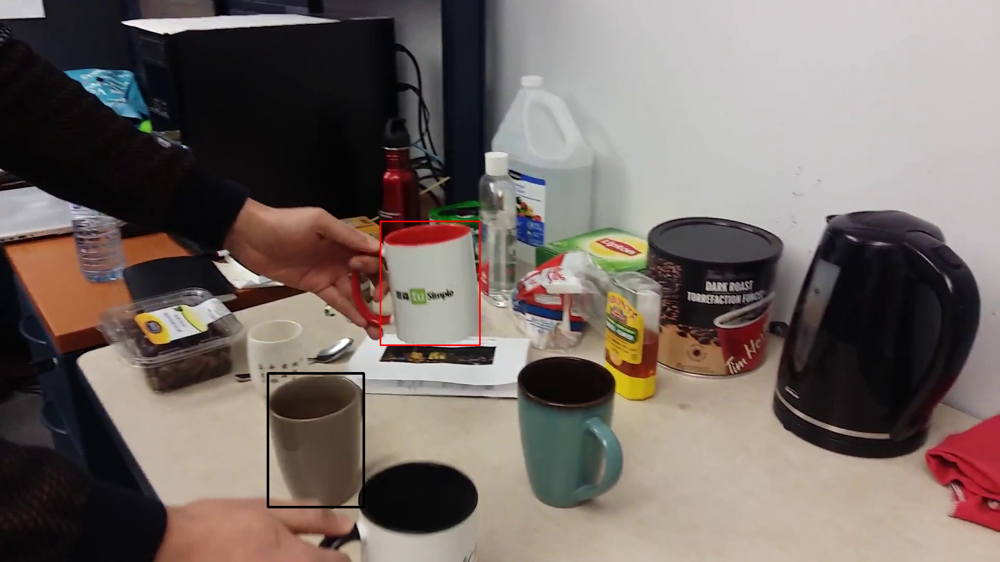

In [ ]:

# cup1Coord, cup2Coord = BuildCoordinateFromText("873 368 338 392 1256 245 309 359")
# imagePath = "drive/My Drive/Colab Notebooks/TP3Vision/frames/frame214.jpg"

# cup1Coord, cup2Coord = BuildCoordinateFromText("607 217 445 482 792 202 293 356")
# imagePath = "drive/My Drive/Colab Notebooks/TP3Vision/frames/frame245.jpg"

# cup1Coord, cup2Coord = BuildCoordinateFromText("837 386 263 310 792 202 293 356")
# imagePath = "drive/My Drive/Colab Notebooks/TP3Vision/frames/frame251.jpg"

# cup1Coord, cup2Coord = BuildCoordinateFromText("695 344 323 582 689 617 205 276")
# imagePath = "drive/My Drive/Colab Notebooks/TP3Vision/frames/frame423.jpg"

# cup1Coord, cup2Coord = BuildCoordinateFromText("739 612 265 368 689 617 205 276")
# imagePath = "drive/My Drive/Colab Notebooks/TP3Vision/frames/frame443.jpg"

# cup1Coord, cup2Coord = BuildCoordinateFromText("589 710 183 356 689 617 205 276")
# imagePath = "drive/My Drive/Colab Notebooks/TP3Vision/frames/frame453.jpg"

# cup1Coord, cup2Coord = BuildCoordinateFromText("504 718 190 259 689 617 205 276")
# imagePath = "drive/My Drive/Colab Notebooks/TP3Vision/frames/frame463.jpg"

# cup1Coord, cup2Coord = BuildCoordinateFromText("567 566 184 257 689 617 205 276")
# imagePath = "drive/My Drive/Colab Notebooks/TP3Vision/frames/frame483.jpg"

cup1Coord, cup2Coord = BuildCoordinateFromText("514 717 184 257 730 425 191 238")
imagePath = "drive/My Drive/Colab Notebooks/TP3Vision/frames/frame461.jpg"

ShowBoxesOnImage(imagePath, cup1Coord , cup2Coord)

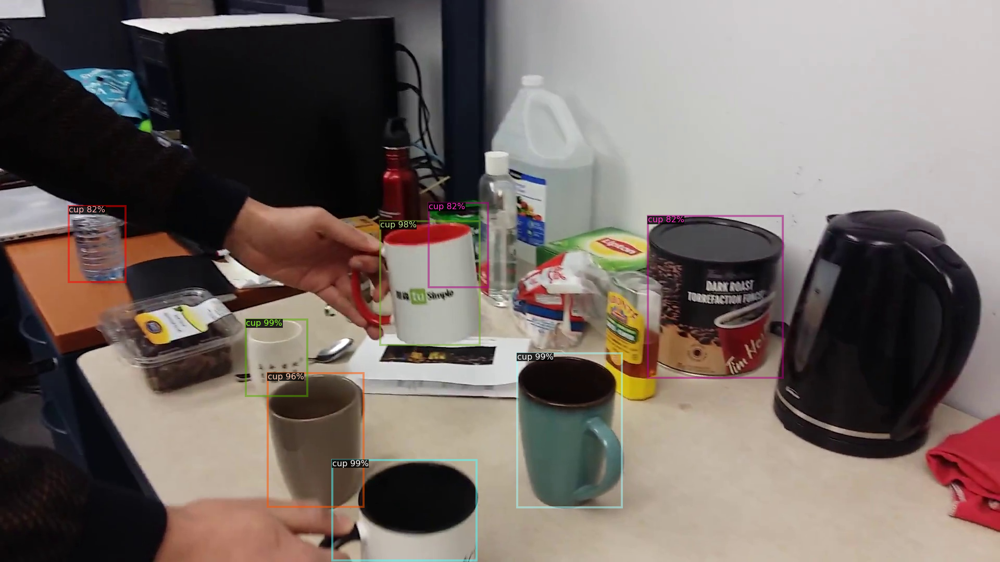

In [ ]:
detector.CupOnImage("drive/My Drive/Colab Notebooks/TP3Vision/frames/frame461.jpg")